<a href="https://colab.research.google.com/github/KancharlaSaiRam/Agriculture_crop_classification/blob/main/Sairam_cs2_error_rate_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### 1.import required libraries

In [ ]:
import numpy as np
from numpy import asarray
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm # color map
import seaborn as sns

import os.path
from os import path

from google.colab import files

import matplotlib.pyplot as plt
import cv2 as cv
import cv2

# Import the necessary libraries
from PIL import Image
from skimage.io import imread

import tqdm 
from tqdm import tqdm

from sklearn.preprocessing import OneHotEncoder,LabelEncoder

import warnings
warnings.filterwarnings("ignore")

!pip3 install pydot
!pip3 install graphviz
from keras.utils.vis_utils import plot_model

import tensorflow as tf

### 2.load dataset

In [ ]:
# refernce how to load the dataset from the kaggle
# refer: https://www.analyticsvidhya.com/blog/2021/06/how-to-load-kaggle-datasets-directly-into-google-colab/
# load the json file from thee device
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"kancharlasairam","key":"6e753fde060715f5f40c889675ec7e5c"}'}

In [ ]:
def load_dataset():
  """
    this function is used to load the dataset based on my required format and folder.
  """
  if path.exists("/content/agriculture-crop-images.zip"):
    print("loaded the dataset...")
  else:
    ! pip install -q kaggle # install the kaggle library
    ! mkdir ~/.kaggle # create root directory
    ! cp kaggle.json ~/.kaggle/ #  Make directory named kaggle and copy kaggle.json file there.

    ! chmod 600 ~/.kaggle/kaggle.json # Change the permissions of the file.
    ! kaggle datasets download -d aman2000jaiswal/agriculture-crop-images # download the dataset with -d / competition with -c
  
  # for my comfort create the kaggle/input directory to unzip the files.

  if path.isdir('/kaggle/input'):  # check if the /kaggle/input exists or not?
  # if the folder is created already.
    if path.exists("/kaggle/input/Crop_details.csv"): # /content/kaggle/input/Crop_details.csv
      print("already existed and loaded...")
    else:
      # unzip the dataset
      # unzip the list of data from the drive list files
      # refer code: !unzip path_to_file.zip -d path_to_directory(destination)  
      print("unzip the dataset....")
      ! unzip /content/agriculture-crop-images.zip -d /kaggle/input
  else: # if the /kaggle/input is not created then create the folders.

      # create kaggle directory for my comfort
      ! mkdir /kaggle
      ! mkdir /kaggle/input
      # unzip the dataset
      print("unzip the dataset ....")
      ! unzip /content/agriculture-crop-images.zip -d /kaggle/input  # unzip the folder into the destination where you required.
  
  return None

In [ ]:
load_dataset() # loaded the dataset 

In [ ]:
load_dataset() # cross check once you loaded the dataset . 

loaded the dataset...
already existed and loaded...


In [ ]:
# cross check the folders and files
path.isdir('/kaggle')
path.exists("/kaggle/input/Crop_details.csv")
path.exists("/kaggle/input/crop_images/jute/jute002a.jpeg")

True

In [ ]:
# load the cropdetails file that contains the 3 columns image path and crop name and crop label. we don't need Unnamed column so drop that.
df = pd.read_csv("/kaggle/input/Crop_details.csv",index_col=None).drop("Unnamed: 0",axis=1)
df.head(3)

,path,crop,croplabel
0,/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg,sugarcane,3
1,/kaggle/input/kag2/sugarcane/sugarcane034a.jpeg,sugarcane,3
2,/kaggle/input/kag2/sugarcane/sugarcane032arot....,sugarcane,3


In [ ]:
# jute -0
# maize -1
# rice -2
# sugarcane-3
# wheat -4
from sklearn.model_selection import train_test_split
x = df["path"]
y = df["crop"]
#df1 = df[['path', 'croplabel']] # takes only the image and mask values
X_train, X_test,y_train,y_test = train_test_split(x,y,test_size=0.11, random_state=42,stratify=y)#dataset is less so takes the 90-10 ratio.
print("the shape of the train data : ",(X_train.shape,y_train.shape))
print("the shape of the test data : ",(X_test.shape,y_test.shape))

the shape of the train data :  ((889,), (889,))
the shape of the test data :  ((110,), (110,))


In [ ]:
from sklearn.preprocessing import OneHotEncoder
from scipy.sparse import csr_matrix

oh = OneHotEncoder()
y_train_oh = oh.fit_transform(y_train.values.reshape(-1,1))
y_train1 = csr_matrix.toarray(y_train_oh)

y_test_oh = oh.transform(y_test.values.reshape(-1,1))
y_test1 = csr_matrix.toarray(y_test_oh)
print("shape of the test data : ",y_test1.shape)
print("shape of the train data : ",y_train1.shape)

shape of the test data :  (110, 5)
shape of the train data :  (889, 5)


In [ ]:
def dataset_creation_pipeline(dataset):
    flat = [] # create an empty list to store the array formatted image.
    for i in tqdm(dataset):
        img = plt.imread(i) # read the image
        img = img/255. # normalize the image
        flat.append(img) # append into the list
    flat_array =  np.array(flat) # convert the list into the array 
    valued_img = flat_array.reshape(-1,224,224,3) # reshape the image into required format here I was used 224,224
    return valued_img

In [ ]:
# dataset be can created from the given image paths
dx_train = dataset_creation_pipeline(X_train)
dx_test = dataset_creation_pipeline(X_test)

100%|██████████| 110/110 [00:00<00:00, 603.48it/s]


In [ ]:
# image generator 
from keras_preprocessing.image import ImageDataGenerator
import pandas as pd
#from tensorflow.keras.preprocessing.image import ImageDataGenerator
#df=pd.read_csv("labels_final.csv")
datagen=ImageDataGenerator(rescale=1./255,validation_split=0.25)

train_generator=datagen.flow_from_dataframe(dataframe=x_train, directory="data_final", x_col="path", y_col="label",class_mode="categorical", target_size=(256,256), batch_size=100,shuffle=True,subset="training")# ,validate_filenames=False
valid_generator=datagen.flow_from_dataframe(dataframe=labels, directory="data_final", x_col="path", y_col="label",class_mode="categorical", target_size=(256,256), batch_size=100,shuffle=True,subset="validation")# ,validate_filenames=False

### 3.model

In [ ]:
import tensorflow as tf 
import keras 
from keras.layers import Conv2D
from keras.models import Sequential
from keras.layers import MaxPool2D
from keras.layers import Flatten
from keras.layers import Dense
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator

import tensorflow as tf
tf.keras.backend.clear_session()
#from tf.keras.optimizers import SGD
from tensorflow import keras
from tensorflow.keras import layers

In [ ]:
from google.colab import files 
files.upload() # load the saved model in the disk.

In [ ]:
# load and evaluate a saved model
from keras.models import load_model
# load model
model = load_model('model.h5')
# summarize model.
#model.summary()

In [ ]:
model.metrics_names

['loss', 'accuracy']

In [ ]:
# evaluate the model
from keras.models import load_model

model=load_model("model.h5")
score = model.evaluate(dx_train, y_train1, verbose=0)
print("%s: %.2f%%" % (model.metrics_names[1], score[1]*100))

accuracy: 100.00%


### 4.FINAL_functions

#### 4.1 finalfunction1

In [ ]:
# final_function1
def predict_crop_image_FUN1(path):
  """
     path as input gives the image with label
  """
  # required libraries
  import cv2 
  import pickle
  import numpy as np
  import matplotlib.pyplot as plt
  from keras.models import load_model

  """
   this function takes image path and predict the crop type among (jute,maize,rice,sugarcane,wheat)

  """
  #predict_datagen = ImageDataGenerator(rescale=1./255)
  #pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"} # predefined the labels
  
  class_labels = ["jute","maize","rice","sugarcane","wheat"]

  # read thwe image and applying the resize and reshaping that image into channels last 
  img = cv2.imread(path) # reead the image 
  img = cv2.resize(img, (224, 224)) # resizing the given image into 224,224
  img = img/255. # scaling the image
  img = np.array(img).reshape((1, 224, 224, 3))

  # load the model
  #best_model = pickle.load(open('best_INCEPTION_model.pkl', 'rb')) # 4
  #best_model = pickle.load(open('best_VGG16_model.pkl', 'rb')) # 3
  # predict the label of the given image
  best_model = load_model('model.h5')
  Y_prediction = best_model.predict(img) # predicting the labels in the array format 1-row , 5-columns.
  y_pred = np.argmax(Y_prediction[0]) # maximum probability value among all the predicted probability of each class. in the first row 

  # plot
  plt.title("prediction : {0} % {1:.2f} : ".format(class_labels[y_pred],Y_prediction[0,y_pred]*100),fontweight = 'bold',fontsize=14, color = 'orange')
  plt.imshow(plt.imread(path)) # plot the given image
  """
  if y_pred == actual:
    print('Correct prediction')
    plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(class_labels[y_pred],Y_prediction[0,y_pred]*100))
  else:
    print("Messed up!!")
    print('Actual class "{0}" and predicted class "{1}"'.format(class_labels[int(y_pred)],class_labels[actual]))
  """

In [ ]:
df.head(2)

,path,crop,croplabel
0,/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg,sugarcane,3
1,/kaggle/input/kag2/sugarcane/sugarcane034a.jpeg,sugarcane,3


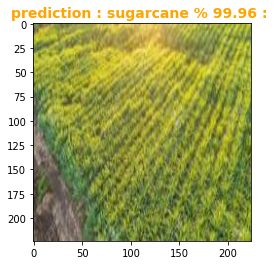

In [ ]:
predict_crop_image_FUN1("/kaggle/input/kag2/sugarcane/sugarcane034a.jpeg")

#### 4.2 final_function2

In [ ]:
# final_function2
def predict_crop_image_FUN2(path,actual):
  # required libraries
  import cv2 
  import pickle
  import numpy as np
  import matplotlib.pyplot as plt
  from keras.models import load_model

  """
   this function takes image path and predict the crop type among (jute,maize,rice,sugarcane,wheat)

  """
  #predict_datagen = ImageDataGenerator(rescale=1./255)
  #pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"} # predefined the labels
  
  class_labels = ["jute","maize","rice","sugarcane","wheat"]

  # read thwe image and applying the resize and reshaping that image into channels last 
  img = cv2.imread(path) # reead the image 
  img = cv2.resize(img, (224, 224)) # resizing the given image into 224,224
  img = img/255. # scaling the image
  img = np.array(img).reshape((1, 224, 224, 3))

  # load the model
  #best_model = pickle.load(open('best_INCEPTION_model.pkl', 'rb')) # 4
  #best_model = pickle.load(open('best_VGG16_model.pkl', 'rb')) # 3
  # predict the label of the given image
  best_model = load_model('model.h5') # load the inception model with architecture and weights.
  Y_prediction = best_model.predict(img) # predicting the labels in the array format 1-row , 5-columns.
  y_pred = np.argmax(Y_prediction[0]) # maximum probability value among all the predicted probability of each class. in the first row 

  # plot
  #plt.title("prediction : {0} % {1:.2f} : ".format(class_labels[y_pred],Y_prediction[0,y_pred]*100),fontweight = 'bold',fontsize=14, color = 'orange')
  #plt.imshow(plt.imread(path)) # plot the given image
  
  #y_predict = class_labels[y_pred]
  y_predl = class_labels[y_pred]
  print("predicted : ",y_predl)
  print("actual : ",actual)

  
  if y_predl == actual:
    print('Correct prediction')
    plt.title("prediction : {0} % {1:.2f} ".format(class_labels[y_pred],Y_prediction[0,y_pred]*100))
    plt.imshow(plt.imread(path)) # plot the given image
  else:
    print("Messed up!!")
    print('Actual class "{0}" and predicted class "{1}"'.format(class_labels[int(y_pred)],actual))#class_labels[actual]))
    plt.imshow(plt.imread(path)) # plot the given image
  

In [ ]:
df["path"][0]

'/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg'

In [ ]:
df.head(3)

,path,crop,croplabel
0,/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg,sugarcane,3
1,/kaggle/input/kag2/sugarcane/sugarcane034a.jpeg,sugarcane,3
2,/kaggle/input/kag2/sugarcane/sugarcane032arot....,sugarcane,3


In [ ]:
df["croplabel"][0]

3

predicted :  sugarcane
actual :  sugarcane
Correct prediction


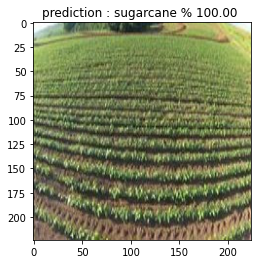

In [ ]:
predict_crop_image_FUN2(df["path"][0],df["crop"][0])

### 5. analysis

#### 5.0 required functions

In [ ]:
def error_analysis(test_data_with_paths,actual_label):
  """
      this function takes the image paths and their labels
      generate 2 dataframes worst_data , correct_data.
      wrong_data contains wrongly classified points and correct_data contain correctly classified points.
  """
  class_labels = ["jute","maize","rice","sugarcane","wheat"]
  
  # load the model  with architecture and weights.
  model = load_model("model.h5")

  # initialize the correctly classified points , wrongly classified points.
  wrongly_imgs = 0 # initilize the wrongly_classified images as zero 
  # create empty lists to store required data
  wrongly_img_paths              = [] # to store image paths
  wrongly_img_actual_labels      = [] # to store actual labels
  wrongly_img_actual_label_score = [] # to store actual label score
  wrongly_img_pred_labels        = [] # to store labels predicted by model
  wrongly_img_pred_label_score   = [] # to store wrongly predicted label score.

  correct_imgs = 0  # initialize the correctly classified points as zero
  # create empty lists to store correctly predicted data
  correct_img_paths       = []  # store image paths
  correct_img_labels      = []  # store the labels
  correct_img_label_score = []  # store the probability  score

  for path ,act_label in zip(test_data_with_paths,actual_label):
    #print("path is ",path)
    #print("image shape is ",img.shape)

    #preprocessing images
    img = cv2.imread(path) # reead the image 
    img = cv2.resize(img, (224, 224)) # resizing the given image into 224,224
    img = img/255. # scaling the image
    img = np.array(img).reshape((1, 224, 224, 3))
    
    y_prediction = model.predict(img)
    #print(type(y_prediction))
    y_pred_idx   = np.argmax(y_prediction[0])
    y_pred_label = class_labels[y_pred_idx]

    #print("y_pred value is :",y_predl)
    #print("label is :",label)

    if y_pred_label == act_label :
      correct_imgs +=1
      correct_img_paths.append(path)
      correct_img_labels.append(act_label)
      score = y_prediction[0,y_pred_idx]*100 # y_prediction is an n-dimensional array 0 row and idx column value we are picked
      correct_img_label_score.append(score)
    else:
      wrongly_imgs +=1
      wrongly_img_paths.append(path)
      wrongly_img_actual_labels.append(act_label)
      score = y_prediction[0,class_labels.index(act_label)]*100
      wrongly_img_actual_label_score.append(score)

      wrongly_img_pred_labels.append(y_pred_label)
      score = y_prediction[0,y_pred_idx]*100
      wrongly_img_pred_label_score.append(score)
  
  print("the correctly classified points : ",correct_imgs)
  print("the wrongly classified points : ",wrongly_imgs)
  # create wrongly classified images dataframe
  wrong_df = pd.DataFrame({ 
                          "path" :wrongly_img_paths,
                          "act_label":wrongly_img_actual_labels,
                          "act_score":wrongly_img_actual_label_score,
                          "pred_label":wrongly_img_pred_labels,
                          "pred_score":wrongly_img_pred_label_score
                           
                        })
  
  # create correctly classified images dataframe
  correct_df = pd.DataFrame({
                            "path":correct_img_paths,
                            "label":correct_img_labels,
                            "score":correct_img_label_score
                       
                          })

  return correct_df,wrong_df # return the dataframes.

In [ ]:
def image_analysis(image_path,crop_name):
  """
  This function takes imagepath and cropname as input and gives the basic image analysis

  """
  im = Image.open(image_path)
  print(" summarize the basic details of the image...")
  print("="*50)
  print("The format of the image : ",im.format)
  print("The size of the image : ",im.size)
  print("The mode of the image : ",im.mode)

  print(crop_name.upper().center(200,"-"))
  pic = cv.imread(image_path)
  plt.figure(figsize=(5,10))
  plt.imshow(pic)
  plt.show()

  # basic properties of the image
  print('Type of the image : ',type(pic))
  print('Shape of the given image : {}'.format(pic.shape))
  print('Image Hight {}'.format(pic.shape[0]))
  print('Image Width {}'.format(pic.shape[1]))
  print('Dimension of Image {}'.format(pic.ndim))
  # The shape of the ndarray is a three layered matrix. The first two numbers here are length and width, and the third number (i.e. 3) is for the three layers: Red, Green, Blue. 
  # So, if we calculate the size of a RGB image, the total size will be counted as height x width x 3

  print('Image size(ht*width*#of channels) : {}'.format(pic.size))

  print('Maximum RGB value in this image : {} '.format(pic.max()))

  print('Minimum RGB value in this image : {} '.format(pic.min()))

  return None


In [ ]:
def image_pixel_analysis(image_path,crop_name,row_val,col_val):
  """
    This function takes the image path , crop name and some pixel of height and width gives the  what is the intensity values at those values.
    gives the how the channels are designed and hw they distributed .
    0index value for Red channel
    1index value for Green channel
    2index value for Blue channel
    
  """

  print(crop_name.upper().center(200,"-"))
  pic = cv.imread(image_path)
  
  # A specific pixel located at Row : 100 ; Column : 50 

  # Each channel's value of it, gradually R , G , B
  print("pixel values at {0} row and {1} column.".format(row_val,col_val))
  print('Value of only R channel {}'.format(pic[row_val, col_val, 0])) # channel-0

  print('Value of only G channel {}'.format(pic[row_val,col_val, 1])) # channel-1

  print('Value of only B channel {}'.format(pic[row_val,col_val, 2])) # channel-2

  figr = plt.figure(figsize=(30,10))
  rows = 1
  columns = 4
  #subplot1
  figr.add_subplot(rows,columns,1)
  plt.title("RGB image",fontweight = 'bold',fontsize=14, color = 'Brown')
  plt.ylabel('{} pxl Height'.format(pic.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic.shape[1]))
  plt.imshow(pic)

  # subplot2
  figr.add_subplot(rows,columns,2) 
  plt.title('Red channel',fontweight = 'bold',fontsize=14, color = 'red')
  plt.ylabel('{} pxl Height'.format(pic.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic.shape[1]))
  plt.imshow(pic[ : , : , 0]) # height range , width range , channel no

  # subplot3
  figr.add_subplot(rows,columns,3)
  plt.title('Green channel',fontweight = 'bold',fontsize=14, color = 'green')
  plt.ylabel('{} pxl Height'.format(pic.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic.shape[1]))
  plt.imshow(pic[ : , : , 1]) # height range , width range ,channel no.

  # subplot4
  figr.add_subplot(rows,columns,4)
  plt.title('Blue channel',fontweight = 'bold',fontsize=14, color = 'blue')
  plt.ylabel('{} pxl Height'.format(pic.shape[0])) # height
  plt.xlabel('{} pxl Width'.format(pic.shape[1]))  # width
  plt.imshow(pic[ : , : , 2]) # height range , width range , channel no
  plt.show()

  figr2 = plt.figure(figsize=(30,5))
  
  #subplot 1
  # tuple to select colors of each channel line
  figr2.add_subplot(rows,columns,1)
  colors = ("red", "green", "blue")
  channel_ids = (0, 1, 2)

  # create the histogram plot, with three lines, one for
  # each color
  figr2.add_subplot(rows,columns,1)
  for channel_id, colr in zip(channel_ids, colors): # iterate through the colors and channel id's.
    histogram, bin_edges = np.histogram(pic[:, :, channel_id], bins=256, range=(0, 256))
    plt.plot(bin_edges[0:-1], histogram, color=colr)
  
  plt.title("Color Histogram")
  plt.xlabel("Color value")
  plt.xlim([0, 256])
  plt.ylabel("Pixel count")
  

  # subplot2
  figr2.add_subplot(rows,columns,2)
  hist1,bin1 = np.histogram(pic[:,:,0],bins=256,range=(0,255+1))
  plt.plot(bin1[0:-1],hist1,color="red")
  plt.title("red Color Histogram")
  plt.xlabel("Color value")
  plt.xlim([0, 256])
  plt.ylabel("Pixel count")


  # subplot3
  figr2.add_subplot(rows,columns,3)
  hist2,bin2 = np.histogram(pic[:,:,1],bins=256,range=(0,255+1))
  plt.plot(bin2[0:-1],hist2,color="Green")
  plt.title("Green color Histogram")
  plt.xlabel("Color value")
  plt.xlim([0, 256])
  plt.ylabel("Pixel count")
  #plt.show()

  # subplot2
  figr2.add_subplot(rows,columns,4)
  hist3,bin3 = np.histogram(pic[:,:,2],bins=256,range=(0,255+1))
  plt.plot(bin3[0:-1],hist3,color="Blue")
  plt.title(" Blue Color Histogram")
  plt.xlabel("Color value")
  plt.xlim([0, 256])
  plt.ylabel("Pixel count")
  plt.show()


  # print(pic)


In [ ]:
def transformations_image(image_path,crop_name):
  print(crop_name.upper().center(200,"-")) # Required. The length of the returned string , The character to fill the missing space on each side. Default is " " (space)

  # reference link for different transformations : https://www.kdnuggets.com/2018/09/image-data-analysis-python-p3.html
  """
     this function is takes the image path ass the input and gives the how the image appeared with different trasformations.
  """

  figr = plt.figure(figsize=(25,10)) # imgwidth,imgheight
  rows =1
  columns = 5
  pic1 = cv.imread(image_path) # read the image into array format
  print("shape of the given image : ",pic1.shape)
  # subplot1
  figr.add_subplot(rows,columns,1)
  plt.title("general image",fontweight = 'bold',fontsize=14, color = 'orange')
  plt.imshow(pic1)
  plt.ylabel('{} pxl Height'.format(pic1.shape[0])) # height
  plt.xlabel('{} pxl Width'.format(pic1.shape[1]))  # width
  #plt.xlabel("image width")
  #plt.ylabel("image height")

  # subplot2
  figr.add_subplot(rows,columns,2)
  plt.title("Normalized image",fontweight = 'bold',fontsize=14, color = 'orange')
  pic11 = (pic1/255)
  plt.imshow(pic11)
  plt.ylabel('{} pxl Height'.format(pic11.shape[0])) # height
  plt.xlabel('{} pxl Width'.format(pic11.shape[1]))  # width
  
  # subplot2 

  pic2 =255- pic1 # neg = (L-1) - img
  figr.add_subplot(rows,columns,3)
  plt.title("negative image",fontweight = 'bold',fontsize=14, color = 'orange')
  plt.imshow(pic2)
  plt.ylabel('{} pxl Height'.format(pic2.shape[0])) # height
  plt.xlabel('{} pxl Width'.format(pic2.shape[1]))  # width
  #plt.xlabel("image width")
  #plt.ylabel("image height")
  #plt.axis('off')

  # subplot3
  gamma=2.2# Gamma < 1 ~ Dark ; Gamma > 1 ~ Bright

  pic3 =((pic1/255)**(1/gamma))
  figr.add_subplot(rows,columns,4)
  plt.imshow(pic3)
  plt.title("gamma Image",fontweight = 'bold',fontsize=14, color = 'orange')
  plt.ylabel('{} pxl Height'.format(pic3.shape[0])) # height
  plt.xlabel('{} pxl Width'.format(pic3.shape[1]))  # width
  #plt.xlabel("image width")
  #plt.ylabel("image height")

  # subplot4 
  pic4 = imread(image_path, as_gray=True)
  figr.add_subplot(rows,columns,5)
  plt.imshow(pic4,cmap=cm.gray) #cmap=cm.gray

  plt.title("gray image",fontweight = 'bold',fontsize=14, color = 'orange')
  plt.ylabel('{} pxl Height'.format(pic4.shape[0])) # height
  plt.xlabel('{} pxl Width'.format(pic4.shape[1]))  # width
  #plt.xlabel("image width")
  #plt.ylabel("image height")

  plt.show()
  figr.savefig('transformation.jpg')
  return None

####  error rate analysis

In [ ]:
model = load_model("model.h5")

In [ ]:
dx_test.shape #110 images.

(110, 224, 224, 3)

In [ ]:
correct_data,wrong_data = error_analysis(X_test[:],y_test[:])

the correctly classified points :  93
the wrongly classified points :  17


<pre>
observation:
1. among 110 data points my model predicts 93 of them correctly and 17 of them wrong.
2. divided my data into 3 parts good , average,worst set based on my score.
3. the data which are wrongly classified images are worst case.
4. the correctly classified images which are contain <90 score considerd as average case.
5 . the correctly classified images which contain >90 score considered as the best case.
</pre>

#### 5.1 wrong_data_analysis:

In [ ]:
wrong_data 

,path,act_label,act_score,pred_label,pred_score
0,/kaggle/input/crop_images/maize/maize008a.jpeg,maize,1.565650,wheat,91.671884
1,/kaggle/input/kag2/wheat/wheat016ahf.jpeg,wheat,2.158857,rice,97.832310
2,/kaggle/input/kag2/maize/maize001ahf.jpeg,maize,15.277579,sugarcane,84.722316
3,/kaggle/input/kag2/maize/maize006hf.jpeg,maize,0.001272,sugarcane,99.997973
4,/kaggle/input/kag2/rice/rice010ahf.jpeg,rice,2.260010,wheat,95.873266
5,/kaggle/input/kag2/maize/maize019ahf.jpeg,maize,0.000051,rice,99.985206
6,/kaggle/input/kag2/rice/rice003arot.jpeg,rice,0.001426,sugarcane,99.758077
7,/kaggle/input/kag2/wheat/wheat031ahf.jpeg,wheat,23.832206,maize,75.979936
8,/kaggle/input/kag2/rice/rice039ahs.jpeg,rice,3.803141,sugarcane,96.179396
9,/kaggle/input/kag2/wheat/wheat0001ahf.jpeg,wheat,40.368047,maize,55.282497


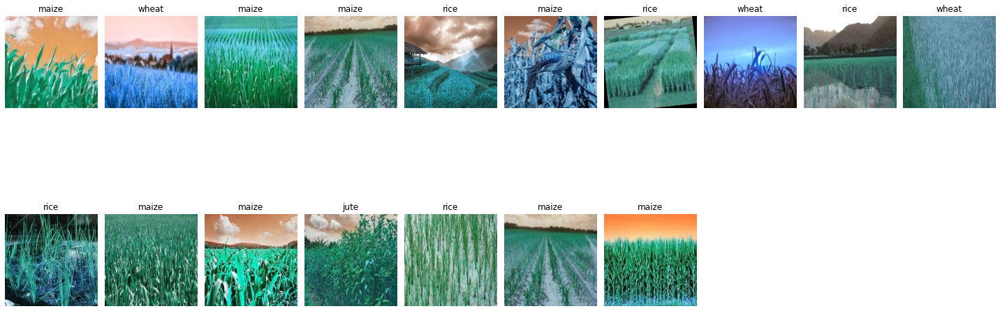

In [ ]:
figr = plt.figure(figsize=(20,10)) # width,height of the figure.
# setting rows and columns
rows=2
columns=10
for imageno,imagepath in enumerate(wrong_data["path"][:]): # takes the 10 rows of the given crop data.
  image = cv.imread(imagepath)
  figr.add_subplot(rows,columns,imageno+1)
  plt.imshow(image)
  plt.axis("off") # it turn off the axis dimensions
  plt.title("{}".format(wrong_data["act_label"][imageno])) # corresponding crop name as the title.
  plt.tight_layout()
plt.show()

<pre>
1. observe most of the images are with different color or with high background color.
2. some of the images are not clear and having some confusion to classify.
3. 17 images are classified wrongly among 110 images
</pre>

##### 5.2.0 jute

In [ ]:
wrong_data[wrong_data["act_label"]=="jute"]

,path,act_label,act_score,pred_label,pred_score
13,/kaggle/input/kag2/jute/jute012ahs.jpeg,jute,0.034984,sugarcane,99.965012


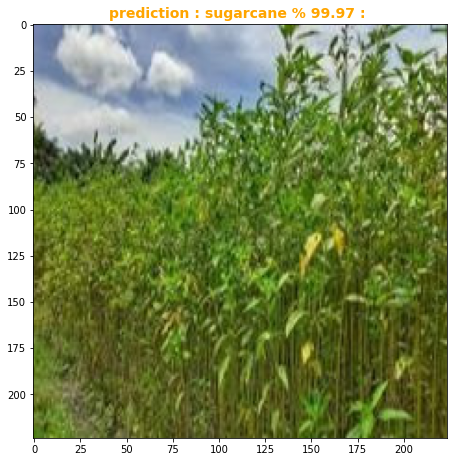

In [ ]:
figr = plt.figure(figsize=(30,10)) # width,height
jute_idx = [13]
rows=1
columns = 5
for imageno ,idx in enumerate(jute_idx):
  ip = wrong_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.tight_layout()
plt.show()

<pre>
1.this jute image is predicted as sugarcane crop with 99% 
2. this image is not clear observe the pixel values are also low at the crop part in the image.
</pre>

--------------------------------------------------------------------------------------------------JUTE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 34
Value of only G channel 114
Value of only B channel 85


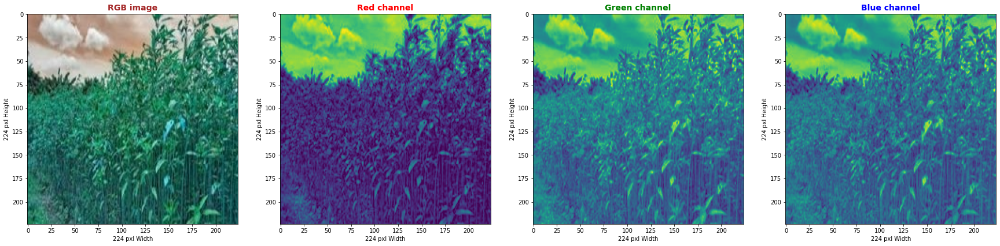

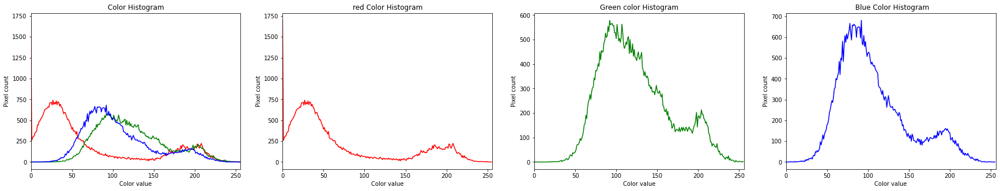

In [ ]:
image_pixel_analysis(wrong_data["path"].iloc[13],"jute",100,100)

##### 5.2.1 maize

In [ ]:
wrong_data[wrong_data["act_label"]=="maize"]

,path,act_label,act_score,pred_label,pred_score
0,/kaggle/input/crop_images/maize/maize008a.jpeg,maize,1.565650,wheat,91.671884
2,/kaggle/input/kag2/maize/maize001ahf.jpeg,maize,15.277579,sugarcane,84.722316
3,/kaggle/input/kag2/maize/maize006hf.jpeg,maize,0.001272,sugarcane,99.997973
5,/kaggle/input/kag2/maize/maize019ahf.jpeg,maize,0.000051,rice,99.985206
11,/kaggle/input/kag2/maize/maize003ahf.jpeg,maize,0.226397,rice,99.474442
12,/kaggle/input/kag2/maize/maize012ahs.jpeg,maize,26.547867,rice,71.951377
15,/kaggle/input/kag2/maize/maize006rot.jpeg,maize,0.007830,sugarcane,99.985015
16,/kaggle/input/kag2/maize/maize002ahf.jpeg,maize,12.917398,jute,55.795789


-------------------------------------------------------------------------------------------------MAIZE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 0
Value of only G channel 74
Value of only B channel 37


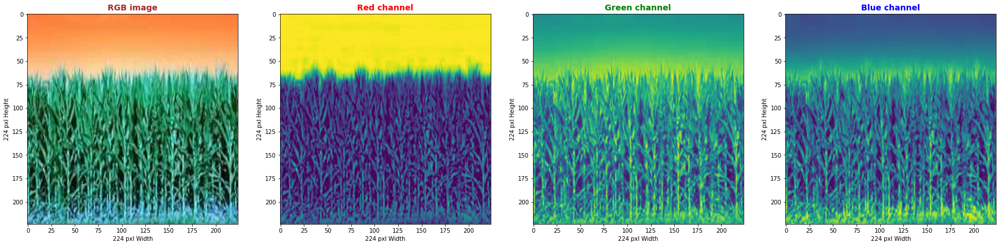

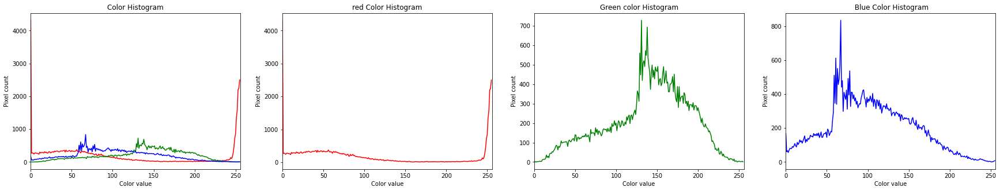

In [ ]:
image_pixel_analysis(wrong_data["path"].iloc[16],"maize",100,100)

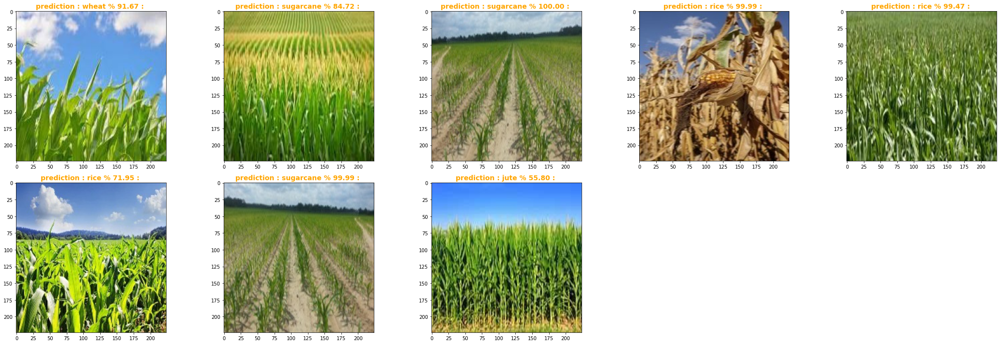

In [ ]:
figr = plt.figure(figsize=(30,10)) # width,height
#maize_idx = [0,1,6,10,14,16]
maize_idx = [0,2,3,5,11,12,15,16]
rows=2
columns = 5
for imageno ,idx in enumerate(maize_idx):
  ip = wrong_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.tight_layout()
plt.show()

<pre>
observation:
1. actually at the initial stages in the aerial view maize and  sugarcane have maximum similarities . to be frank human also confused some times.
2. the images which are predicted as rice are 4th image in brown color at the same time it shows the single corn . if we joom the rice crop image at the final stage both are same.

3. remaining are cropped parts of the original images. to avoid confusion we need to do add some more images .
</pre>

##### 5.2.2 rice

In [ ]:
wrong_data[wrong_data["act_label"]=="rice"]

,path,act_label,act_score,pred_label,pred_score
4,/kaggle/input/kag2/rice/rice010ahf.jpeg,rice,2.260010,wheat,95.873266
6,/kaggle/input/kag2/rice/rice003arot.jpeg,rice,0.001426,sugarcane,99.758077
8,/kaggle/input/kag2/rice/rice039ahs.jpeg,rice,3.803141,sugarcane,96.179396
10,/kaggle/input/kag2/rice/rice036ahf.jpeg,rice,43.506086,sugarcane,56.489623
14,/kaggle/input/kag2/rice/rice034ahf.jpeg,rice,31.102297,wheat,68.891746


In [ ]:
image_pixel_analysis(wrong_data["path"].iloc[14],"rice",100,100)

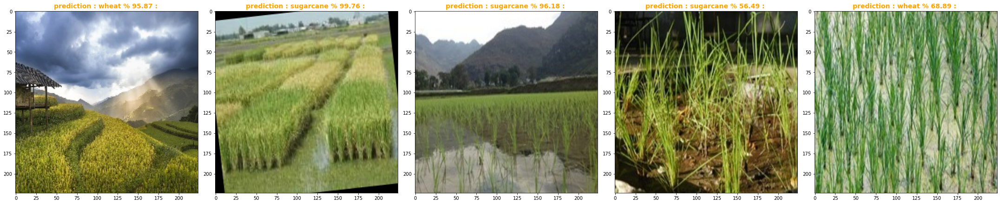

In [ ]:
#rice_idx = [3,4,5,7,8,9,12,13,17,18,19]
rice_idx = [4,6,8,10,14]
figr = plt.figure(figsize=(30,10))
rows=1
columns = 5
for imageno ,idx in enumerate(rice_idx):
  ip = wrong_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
  plt.tight_layout()
plt.show()

<pre>
observation:
1. image1,imag2 is not clear those images are rare pattrens so we need to add those type of rare images to my training to learn my model more about this type of irregular pattrens.
2. we need to add some more images of rice crop at initial stage images that will help to reduce the errors.
3. here wrongly predicted images have irregular paatrens so rare of these type of rice images are appeared.
</pre>

##### 5.2.3 sugarcane

In [ ]:
wrong_data[wrong_data["act_label"]=="sugarcane"]

,path,act_label,act_score,pred_label,pred_score


In [ ]:
figr = plt.figure(figsize=(30,10))
sugarcane_idx = []
rows=1
columns = 6
for imageno ,idx in enumerate(sugarcane_idx):
  ip = wrong_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

<Figure size 2160x1440 with 0 Axes>

<pre>
observation:
1. this crop can be classified correctly.
</pre>

##### 5.2.4 wheat

In [ ]:
wrong_data[wrong_data["act_label"]=="wheat"]

,path,act_label,act_score,pred_label,pred_score
1,/kaggle/input/kag2/wheat/wheat016ahf.jpeg,wheat,2.158857,rice,97.832310
7,/kaggle/input/kag2/wheat/wheat031ahf.jpeg,wheat,23.832206,maize,75.979936
9,/kaggle/input/kag2/wheat/wheat0001ahf.jpeg,wheat,40.368047,maize,55.282497


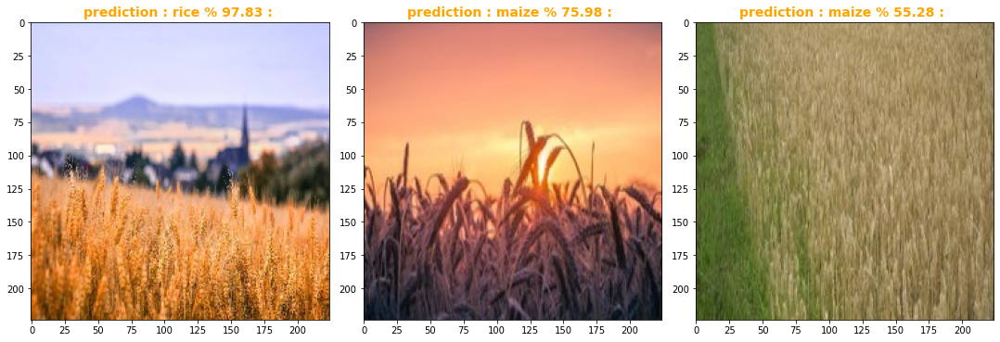

In [ ]:
figr = plt.figure(figsize=(30,10))
wheat_idx = [1,7,9]
rows=1
columns = 6
for imageno ,idx in enumerate(wheat_idx):
  ip = wrong_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.tight_layout()
plt.show()

<pre>
observation:
1. here images are not clear.
2. for the image 2,image3 wheat score is also good but it gives more score to the maize.
</pre>

##### act vs pred

In [ ]:
wrong_data[(wrong_data["pred_label"]=="jute" ) | (wrong_data["act_label"]=="jute")]

,path,act_label,act_score,pred_label,pred_score
13,/kaggle/input/kag2/jute/jute012ahs.jpeg,jute,0.034984,sugarcane,99.965012
16,/kaggle/input/kag2/maize/maize002ahf.jpeg,maize,12.917398,jute,55.795789


In [ ]:
wrong_data[(wrong_data["pred_label"]=="maize" ) | (wrong_data["act_label"]=="maize")]

,path,act_label,act_score,pred_label,pred_score
0,/kaggle/input/crop_images/maize/maize008a.jpeg,maize,1.565650,wheat,91.671884
2,/kaggle/input/kag2/maize/maize001ahf.jpeg,maize,15.277579,sugarcane,84.722316
3,/kaggle/input/kag2/maize/maize006hf.jpeg,maize,0.001272,sugarcane,99.997973
5,/kaggle/input/kag2/maize/maize019ahf.jpeg,maize,0.000051,rice,99.985206
7,/kaggle/input/kag2/wheat/wheat031ahf.jpeg,wheat,23.832206,maize,75.979936
9,/kaggle/input/kag2/wheat/wheat0001ahf.jpeg,wheat,40.368047,maize,55.282497
11,/kaggle/input/kag2/maize/maize003ahf.jpeg,maize,0.226397,rice,99.474442
12,/kaggle/input/kag2/maize/maize012ahs.jpeg,maize,26.547867,rice,71.951377
15,/kaggle/input/kag2/maize/maize006rot.jpeg,maize,0.007830,sugarcane,99.985015
16,/kaggle/input/kag2/maize/maize002ahf.jpeg,maize,12.917398,jute,55.795789


In [ ]:
wrong_data[(wrong_data["pred_label"]=="rice" ) | (wrong_data["act_label"]=="rice")]

,path,act_label,act_score,pred_label,pred_score
1,/kaggle/input/kag2/wheat/wheat016ahf.jpeg,wheat,2.158857,rice,97.832310
4,/kaggle/input/kag2/rice/rice010ahf.jpeg,rice,2.260010,wheat,95.873266
5,/kaggle/input/kag2/maize/maize019ahf.jpeg,maize,0.000051,rice,99.985206
6,/kaggle/input/kag2/rice/rice003arot.jpeg,rice,0.001426,sugarcane,99.758077
8,/kaggle/input/kag2/rice/rice039ahs.jpeg,rice,3.803141,sugarcane,96.179396
10,/kaggle/input/kag2/rice/rice036ahf.jpeg,rice,43.506086,sugarcane,56.489623
11,/kaggle/input/kag2/maize/maize003ahf.jpeg,maize,0.226397,rice,99.474442
12,/kaggle/input/kag2/maize/maize012ahs.jpeg,maize,26.547867,rice,71.951377
14,/kaggle/input/kag2/rice/rice034ahf.jpeg,rice,31.102297,wheat,68.891746


In [ ]:
wrong_data[(wrong_data["pred_label"]=="sugarcane" ) | (wrong_data["act_label"]=="sugarcane")] # &,|,~

,path,act_label,act_score,pred_label,pred_score
2,/kaggle/input/kag2/maize/maize001ahf.jpeg,maize,15.277579,sugarcane,84.722316
3,/kaggle/input/kag2/maize/maize006hf.jpeg,maize,0.001272,sugarcane,99.997973
6,/kaggle/input/kag2/rice/rice003arot.jpeg,rice,0.001426,sugarcane,99.758077
8,/kaggle/input/kag2/rice/rice039ahs.jpeg,rice,3.803141,sugarcane,96.179396
10,/kaggle/input/kag2/rice/rice036ahf.jpeg,rice,43.506086,sugarcane,56.489623
13,/kaggle/input/kag2/jute/jute012ahs.jpeg,jute,0.034984,sugarcane,99.965012
15,/kaggle/input/kag2/maize/maize006rot.jpeg,maize,0.007830,sugarcane,99.985015


In [ ]:
wrong_data[(wrong_data["pred_label"]=="wheat" ) | (wrong_data["act_label"]=="wheat")]

,path,act_label,act_score,pred_label,pred_score
0,/kaggle/input/crop_images/maize/maize008a.jpeg,maize,1.565650,wheat,91.671884
1,/kaggle/input/kag2/wheat/wheat016ahf.jpeg,wheat,2.158857,rice,97.832310
4,/kaggle/input/kag2/rice/rice010ahf.jpeg,rice,2.260010,wheat,95.873266
7,/kaggle/input/kag2/wheat/wheat031ahf.jpeg,wheat,23.832206,maize,75.979936
9,/kaggle/input/kag2/wheat/wheat0001ahf.jpeg,wheat,40.368047,maize,55.282497
14,/kaggle/input/kag2/rice/rice034ahf.jpeg,rice,31.102297,wheat,68.891746


In [ ]:
wrong_data["pred_label"].value_counts()

sugarcane    7
rice         4
wheat        3
maize        2
jute         1
Name: pred_label, dtype: int64

In [ ]:
wrong_data["act_label"].value_counts()

maize    8
rice     5
wheat    3
jute     1
Name: act_label, dtype: int64

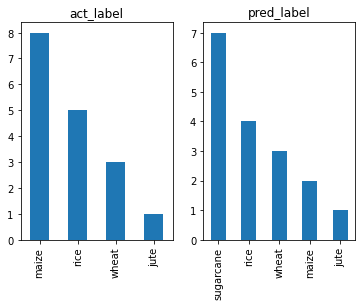

In [ ]:
categorical_features = ["act_label", "pred_label"]
fig, ax = plt.subplots(1, len(categorical_features))
for i, categorical_feature in enumerate(wrong_data[categorical_features]):
    wrong_data[categorical_feature].value_counts().plot(kind="bar", ax=ax[i]).set_title(categorical_feature)
fig.show()


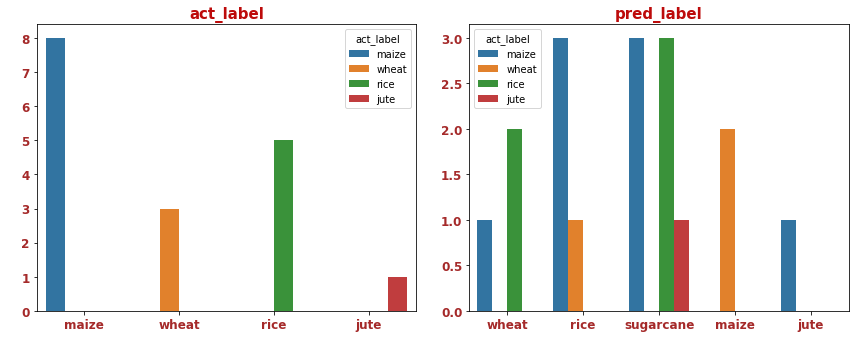

In [ ]:
plt.figure(figsize = (18,5))
categorical = ["act_label","pred_label"]
for i,col in enumerate(categorical):
  plt.subplot(1,3,i+1)
  sns.countplot(x = col,  data = wrong_data, hue = 'act_label' )
  plt.xticks(rotation = 0)
  plt.title(col, fontsize = 15, fontweight = 'bold', color = '#bd0b0b')
  plt.xlabel(" ")
  plt.ylabel(" ")
  plt.xticks(fontsize = 12, fontweight = 'bold', color = 'brown')
  plt.yticks(fontsize = 12, fontweight = 'bold', color = 'brown')
  plt.tight_layout()

<pre>
observation of wrong classified images:
1. actually I have 8 maize crop images those are predicted as 1 wheat crop , 3 of them are rice , 3 of them are sugarcane , remaining one is predicted as jute crop.

2. actually I have 3 wheat crop images but  those are predicted as 1 image as rice crop , remaining 2 are predicted as maize crop.

3. I have an 5 rice crop images among those images 2 images are considered as wheat crop , remaining are considered as sugarcane crop images.

4. I have an one jute image that image predicted as sugarcane image.
</pre>

#### correct_data_analysis

In [ ]:
correct_data.head()

,path,label,score
0,/kaggle/input/kag2/rice/rice036ahs.jpeg,rice,87.803990
1,/kaggle/input/kag2/jute/jute003ahf.jpeg,jute,99.999166
2,/kaggle/input/kag2/jute/jute016ahs.jpeg,jute,99.996805
3,/kaggle/input/kag2/jute/jute017arot.jpeg,jute,99.998868
4,/kaggle/input/kag2/maize/maize036a.jpeg,maize,99.999571


In [ ]:
wrong_data["act_label"].value_counts()

maize    8
rice     5
wheat    3
jute     1
Name: act_label, dtype: int64

In [ ]:
correct_data["label"].value_counts()

sugarcane    22
jute         21
wheat        19
rice         17
maize        14
Name: label, dtype: int64

<pre>
observation:
1. my model predicts sugarcane well .
2. remaining crops having some wrongly classified crops
3. this correct data can be divided into 2 other sets  based on the predicted probability scores.
</pre>

#### 5.2 medium_data_analysis

In [ ]:
# average score
medium_data = correct_data[correct_data["score"]<90]
medium_data
# if the predicted probability score of the correct class is less than 90 those images are considered as the average images data.

,path,label,score
0,/kaggle/input/kag2/rice/rice036ahs.jpeg,rice,87.803990
16,/kaggle/input/kag2/maize/maize027ahs.jpeg,maize,70.678246
22,/kaggle/input/crop_images/sugarcane/sugarcane0...,sugarcane,45.989621
29,/kaggle/input/kag2/rice/rice024a.jpeg,rice,85.688597
37,/kaggle/input/kag2/maize/maize013arot.jpeg,maize,56.710619
51,/kaggle/input/kag2/maize/maize027arot.jpeg,maize,70.678246
77,/kaggle/input/crop_images/maize/maize035a.jpeg,maize,86.048865
89,/kaggle/input/kag2/rice/rice026a.jpeg,rice,63.240874


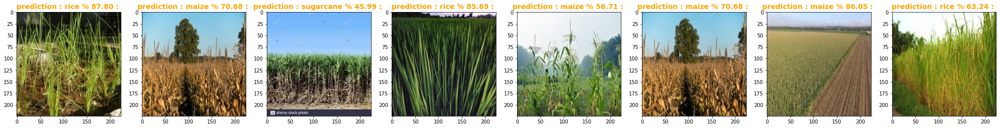

In [ ]:
medium_data_idx = [0,16,22,29,37,51,77,89]
figr = plt.figure(figsize=(35,25))
rows=1
columns = 8
for imageno,idx in enumerate(medium_data_idx):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

<pre>
observation:
1 . most of the correctly classified images are more than 90 % probability score.
2 . there is some confusion between the sugarcane, rice, maize. 
3 . predicted with correct class label..
</pre>

##### 5.2.0 jute

In [ ]:
medium_data[medium_data["label"]=="jute"]

,path,label,score


In [ ]:
# all correctly classified jute images are having more than 90% probability score values.

##### 5.2.1 maize

In [ ]:
medium_data[medium_data["label"]=="maize"]

,path,label,score
16,/kaggle/input/kag2/maize/maize027ahs.jpeg,maize,70.678246
37,/kaggle/input/kag2/maize/maize013arot.jpeg,maize,56.710619
51,/kaggle/input/kag2/maize/maize027arot.jpeg,maize,70.678246
77,/kaggle/input/crop_images/maize/maize035a.jpeg,maize,86.048865


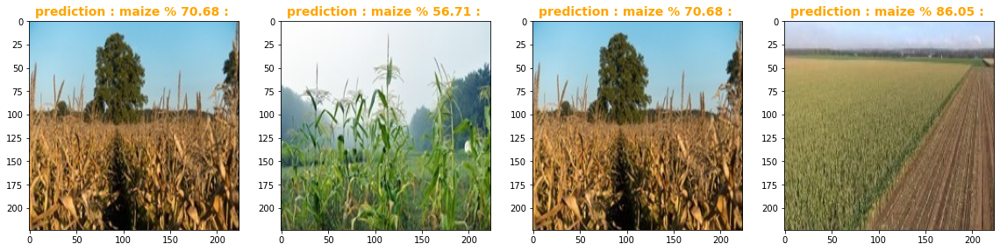

In [ ]:
figr = plt.figure(figsize=(30,20))
#maize_idx2 = [29,37,69,89]
maize_idx2 = [16,37,51,77]
rows=1
columns = 6
for imageno ,idx in enumerate(maize_idx2):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

In [ ]:
# we have some confused images of the maize crop those are  predicted with less than 90% probility score values.

##### 5.2.2 rice

In [ ]:
medium_data[medium_data["label"]=="rice"]

,path,label,score
0,/kaggle/input/kag2/rice/rice036ahs.jpeg,rice,87.803990
29,/kaggle/input/kag2/rice/rice024a.jpeg,rice,85.688597
89,/kaggle/input/kag2/rice/rice026a.jpeg,rice,63.240874


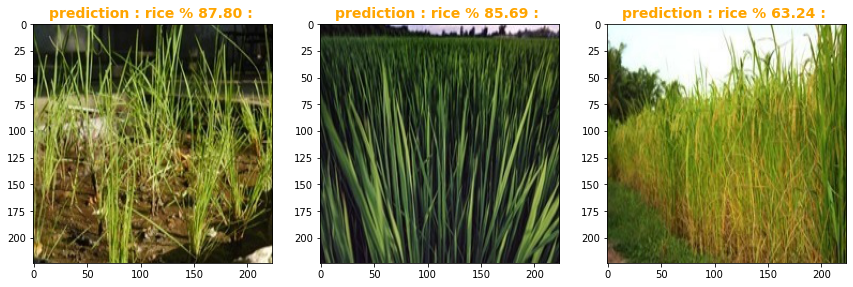

In [ ]:
figr = plt.figure(figsize=(30,20))
#rice_idx2 = [18,28,39,51,74]
rice_idx2 = [0,29,89]
rows=1
columns = 6
for imageno ,idx in enumerate(rice_idx2):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

In [ ]:
# here the above mentioned images having some confusion these are rarely appeared in rice crop compare to the other crop images.
# 3rd rice crop image is the zoomed picture and it is looks similar to the sugarcane .

##### 5.2.3 sugarcane

In [ ]:
medium_data[medium_data["label"]=="sugarcane"]

,path,label,score
22,/kaggle/input/crop_images/sugarcane/sugarcane0...,sugarcane,45.989621


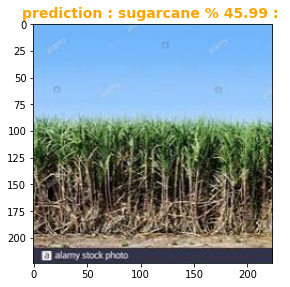

In [ ]:
figr = plt.figure(figsize=(30,20))
#sugarcane_idx2 = [12,21,26,64,82,88]
sugarcane_idx2 = [22]
rows=1
columns = 6
for imageno ,idx in enumerate(sugarcane_idx2):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

In [ ]:
# the above image is the sugarcane image but the crop image part is less compare to the sky part in the image.

##### 5.2.4 wheat

In [ ]:
medium_data[medium_data["label"]=="wheat"]

,path,label,score


In [ ]:
figr = plt.figure(figsize=(10,20))
#wheat_idx2 = [13,34]
wheat_idx2 = []
rows=1
columns = 2
for imageno ,idx in enumerate(wheat_idx2):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

<Figure size 720x1440 with 0 Axes>

In [ ]:
# all the wheat images are classified correctly

#### 5.3 good_data analysis

In [ ]:
# I picked the images which images are having the 100% score of the actual label.
good_data = correct_data[correct_data["score"]==100]
good_data.shape

(28, 3)

##### 5.3.0 jute

In [ ]:
good_data[good_data["label"]=="jute"]

,path,label,score
19,/kaggle/input/kag2/jute/jute006arot.jpeg,jute,100.0
27,/kaggle/input/kag2/jute/jute038arot.jpeg,jute,100.0
33,/kaggle/input/kag2/jute/jute009a.jpeg,jute,100.0
46,/kaggle/input/kag2/jute/jute011a.jpeg,jute,100.0
47,/kaggle/input/kag2/jute/jute020arot.jpeg,jute,100.0
69,/kaggle/input/kag2/jute/jute028ahs.jpeg,jute,100.0
84,/kaggle/input/crop_images/jute/jute005a.jpeg,jute,100.0


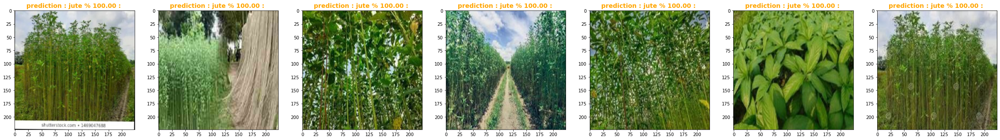

In [ ]:
figr = plt.figure(figsize=(40,20))
jute_idx3 = [19,27,33,46,47,69,84]
wheat_idx2 = []
rows=1
columns = 7
for imageno ,idx in enumerate(jute_idx3):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

--------------------------------------------------------------------------------------------------JUTE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 101
Value of only G channel 164
Value of only B channel 125


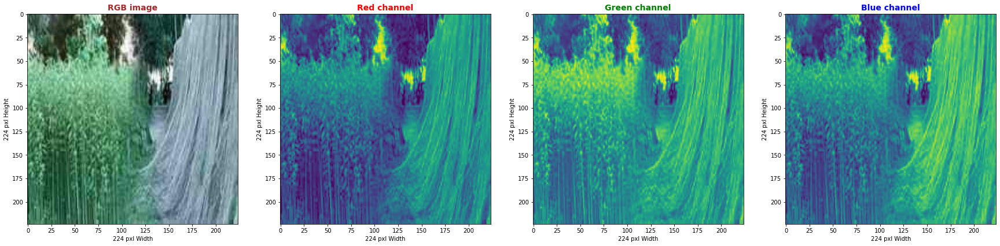

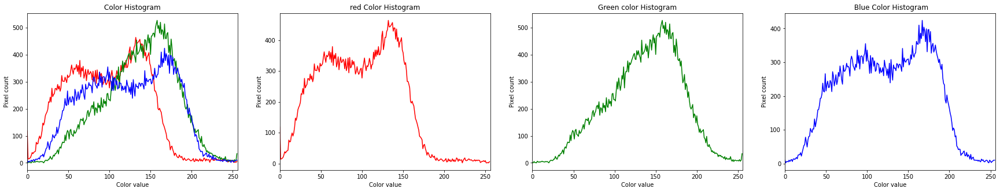

In [ ]:
image_pixel_analysis(correct_data["path"].iloc[27],"jute",100,100)

##### 5.3.1 maize

In [ ]:
good_data[good_data["label"]=="maize"]

,path,label,score
30,/kaggle/input/kag2/maize/maize010ahf.jpeg,maize,100.0
31,/kaggle/input/kag2/maize/maize028a.jpeg,maize,100.0
74,/kaggle/input/crop_images/maize/maize016a.jpeg,maize,100.0
79,/kaggle/input/crop_images/maize/maize025a.jpeg,maize,100.0


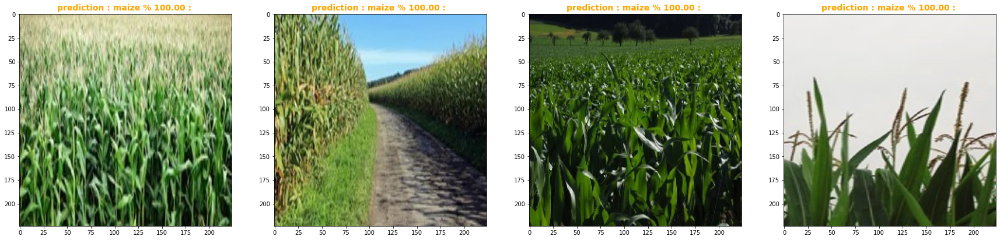

In [ ]:
figr = plt.figure(figsize=(30,20))
maize_idx3 = [30,31,74,79]
rows=1
columns = 4
for imageno ,idx in enumerate(maize_idx3):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

##### 5.3.2 rice

In [ ]:
good_data[good_data["label"]=="rice"]

,path,label,score
75,/kaggle/input/kag2/rice/rice035ahf.jpeg,rice,100.0


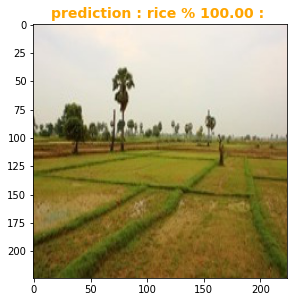

In [ ]:
figr = plt.figure(figsize=(10,20))
rice_idx3 = [75]
rows=1
columns = 2
for imageno ,idx in enumerate(rice_idx3):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 51
Value of only G channel 115
Value of only B channel 110


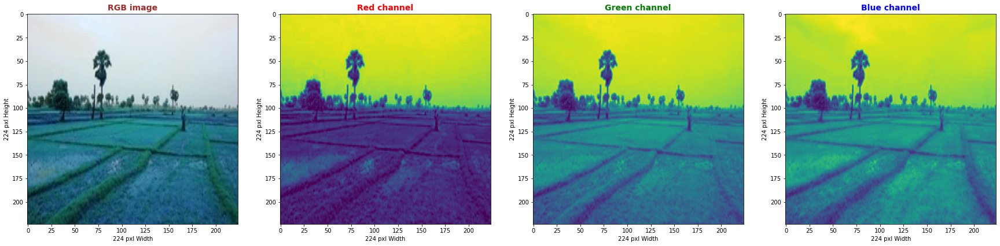

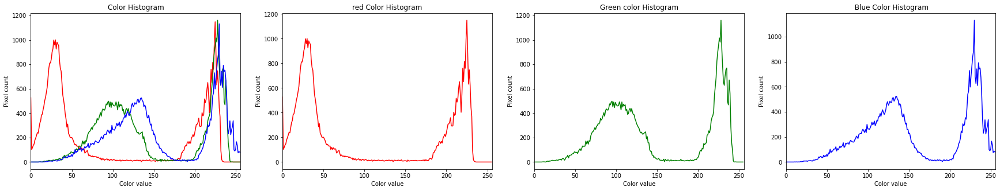

In [ ]:
image_pixel_analysis(correct_data["path"].iloc[75],"rice",100,100)

##### 5.3.3 sugarcane

In [ ]:
good_data[good_data["label"]=="sugarcane"]

,path,label,score
12,/kaggle/input/kag2/sugarcane/sugarcane039a.jpeg,sugarcane,100.0
15,/kaggle/input/kag2/sugarcane/sugarcane008arot....,sugarcane,100.0
24,/kaggle/input/kag2/sugarcane/sugarcane0003a.jpeg,sugarcane,100.0
36,/kaggle/input/crop_images/sugarcane/sugarcane0...,sugarcane,100.0
43,/kaggle/input/kag2/sugarcane/sugarcane006a.jpeg,sugarcane,100.0
49,/kaggle/input/kag2/sugarcane/sugarcane033ahs.jpeg,sugarcane,100.0
54,/kaggle/input/crop_images/sugarcane/sugarcane0...,sugarcane,100.0
59,/kaggle/input/crop_images/sugarcane/sugarcane0...,sugarcane,100.0
66,/kaggle/input/kag2/sugarcane/sugarcane024a.jpeg,sugarcane,100.0
76,/kaggle/input/kag2/sugarcane/sugarcane031arot....,sugarcane,100.0


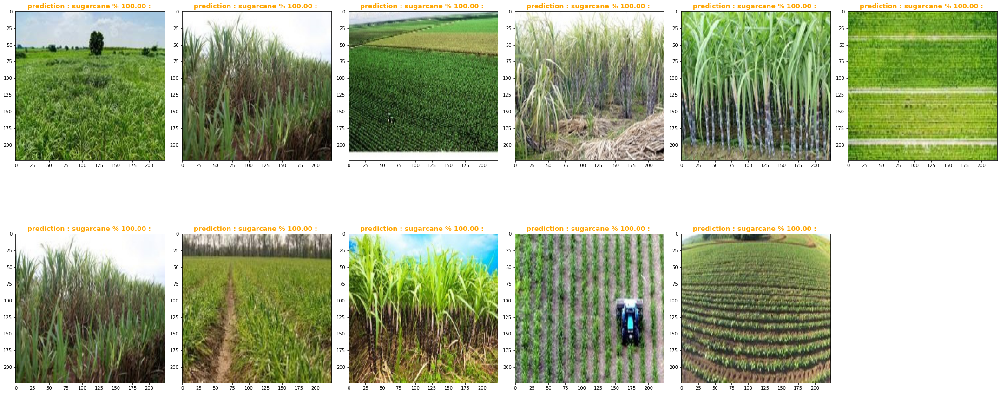

In [ ]:
figr = plt.figure(figsize=(30,15))
sugarcane_idx3 = [12,15,24,36,43,49,54,59,66,76,83]
rows=2
columns = 6
for imageno ,idx in enumerate(sugarcane_idx3):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
  plt.tight_layout()
plt.show()

##### 5.3.4 wheat

In [ ]:
good_data[good_data["label"]=="wheat"]

,path,label,score
25,/kaggle/input/crop_images/wheat/wheat029a.jpeg,wheat,100.0
42,/kaggle/input/crop_images/wheat/wheat030a.jpeg,wheat,100.0
52,/kaggle/input/kag2/wheat/wheat029a.jpeg,wheat,100.0
81,/kaggle/input/kag2/wheat/wheat039ahs.jpeg,wheat,100.0
86,/kaggle/input/crop_images/wheat/wheat034a.jpeg,wheat,100.0


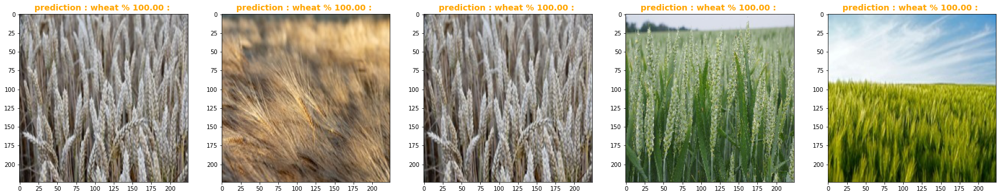

In [ ]:
figr = plt.figure(figsize=(30,20))
#wheat_idx2 = [13,34]
wheat_idx3 = [25,42,52,81,86]
rows=1
columns = 5
for imageno ,idx in enumerate(wheat_idx3):
  ip = correct_data["path"].iloc[idx]
  figr.add_subplot(rows,columns,imageno+1)
  predict_crop_image_FUN1(ip)
plt.show()

-------------------------------------------------------------------------------------------------WHEAT--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 137
Value of only G channel 178
Value of only B channel 210


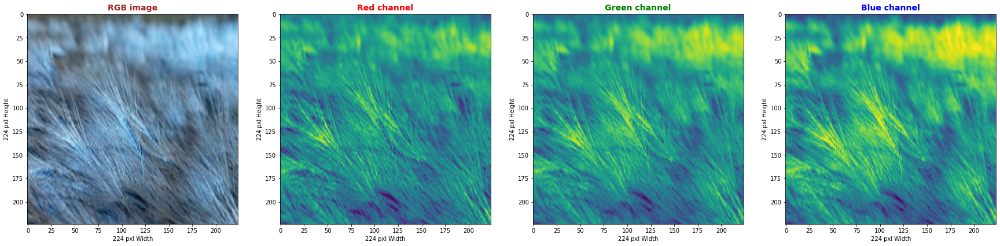

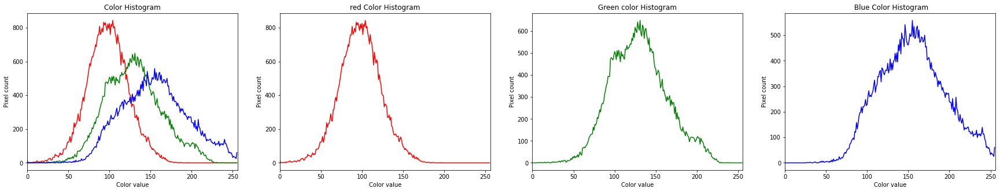

In [ ]:
image_pixel_analysis(correct_data["path"].iloc[42],"wheat",100,100)

#### 5.4 comparison data analysis

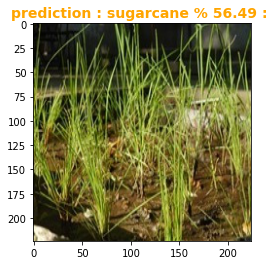

In [ ]:
predict_crop_image_FUN1(wrong_data["path"].iloc[10])

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 69
Value of only G channel 159
Value of only B channel 154


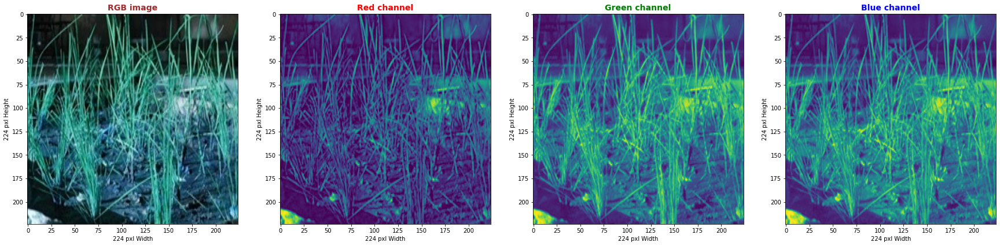

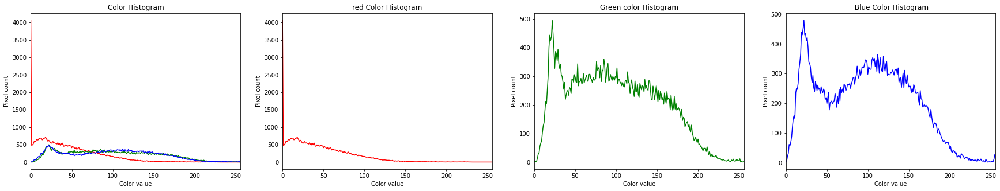

In [ ]:
image_pixel_analysis(wrong_data["path"].iloc[10],"rice",100,100)

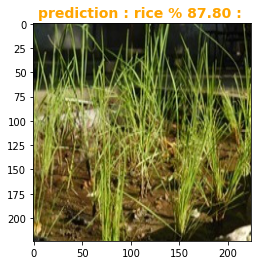

In [ ]:
predict_crop_image_FUN1(correct_data["path"].iloc[0])

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 55
Value of only G channel 147
Value of only B channel 136


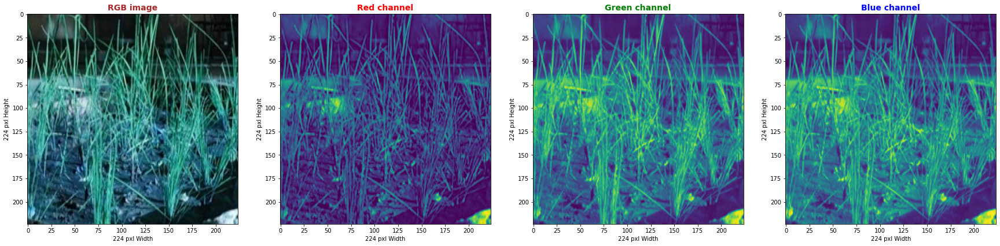

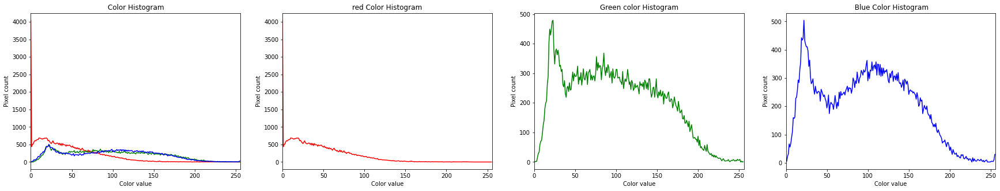

In [ ]:
image_pixel_analysis(correct_data["path"].iloc[0],"rice",100,100)

In [ ]:
ipr1 = correct_data["path"].iloc[0]
ipr2 = wrong_data["path"].iloc[10]

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
shape of the given image :  (224, 224, 3)


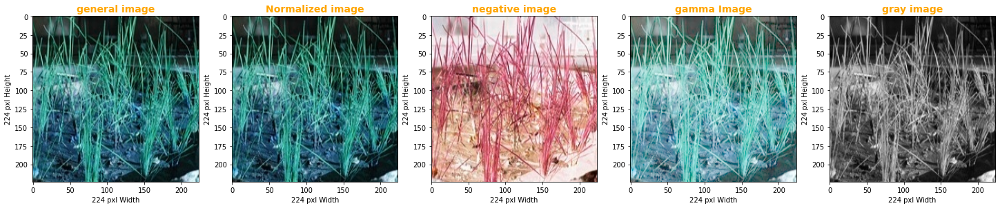

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
shape of the given image :  (224, 224, 3)


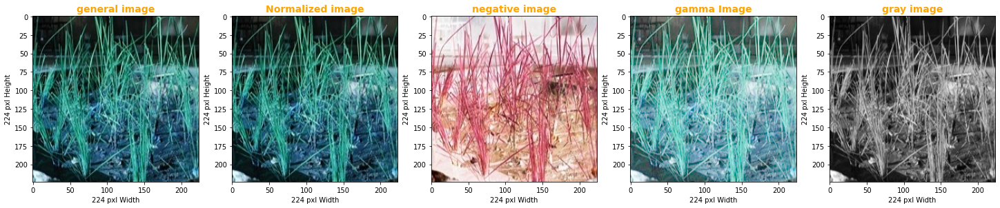

In [ ]:
transformations_image(ipr1,"rice")
transformations_image(ipr2,"rice")

<pre>
observation:
1.both images are looks like similar one of them is classified as the rice and another one is with sugarcane   actually both are rice crop images.

2. but their pixel values are different at same position and distribution of the pixels are mostly same.

3. because of small change in pixel values whole class label is classified wrongly .
</pre>

In [ ]:
wrong_data
#medium_data
#good_data

,path,act_label,act_score,pred_label,pred_score
0,/kaggle/input/crop_images/maize/maize008a.jpeg,maize,1.565650,wheat,91.671884
1,/kaggle/input/kag2/wheat/wheat016ahf.jpeg,wheat,2.158857,rice,97.832310
2,/kaggle/input/kag2/maize/maize001ahf.jpeg,maize,15.277579,sugarcane,84.722316
3,/kaggle/input/kag2/maize/maize006hf.jpeg,maize,0.001272,sugarcane,99.997973
4,/kaggle/input/kag2/rice/rice010ahf.jpeg,rice,2.260010,wheat,95.873266
5,/kaggle/input/kag2/maize/maize019ahf.jpeg,maize,0.000051,rice,99.985206
6,/kaggle/input/kag2/rice/rice003arot.jpeg,rice,0.001426,sugarcane,99.758077
7,/kaggle/input/kag2/wheat/wheat031ahf.jpeg,wheat,23.832206,maize,75.979936
8,/kaggle/input/kag2/rice/rice039ahs.jpeg,rice,3.803141,sugarcane,96.179396
9,/kaggle/input/kag2/wheat/wheat0001ahf.jpeg,wheat,40.368047,maize,55.282497


-------------------------------------------------------------------------------------------------MAIZE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 34
Value of only G channel 161
Value of only B channel 135


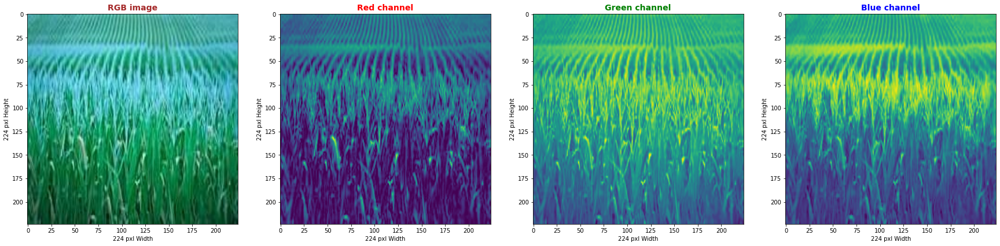

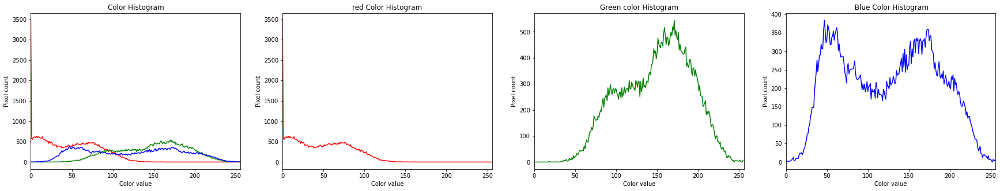

In [ ]:
image_pixel_analysis(wrong_data["path"].iloc[2],"maize",100,100)

In [ ]:
rice_idx

[4, 6, 8, 10, 14]

In [ ]:
rice_idx2

[0, 29, 89]

In [ ]:
medium_data[medium_data["label"]=="rice"]

,path,label,score
0,/kaggle/input/kag2/rice/rice036ahs.jpeg,rice,87.803990
29,/kaggle/input/kag2/rice/rice024a.jpeg,rice,85.688597
89,/kaggle/input/kag2/rice/rice026a.jpeg,rice,63.240874


In [ ]:
rice_idx3

[75]

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 81
Value of only G channel 163
Value of only B channel 141


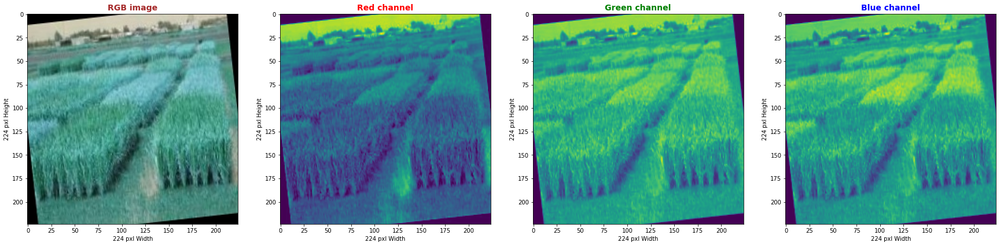

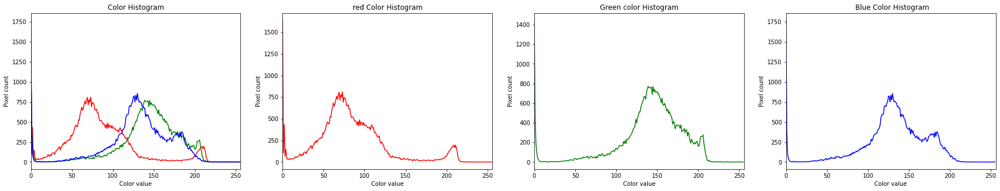

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 55
Value of only G channel 147
Value of only B channel 136


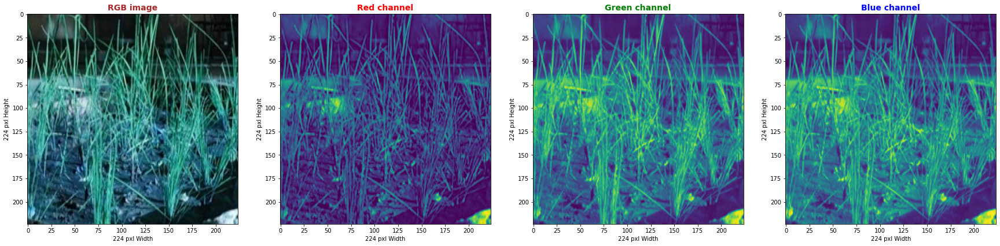

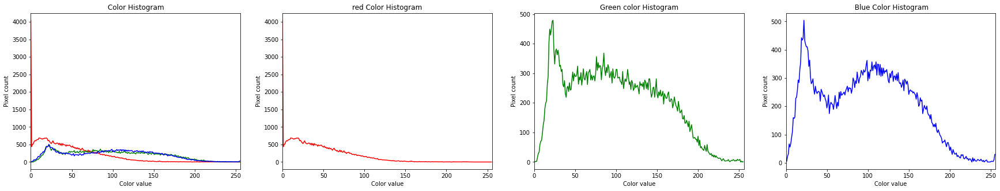

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 51
Value of only G channel 115
Value of only B channel 110


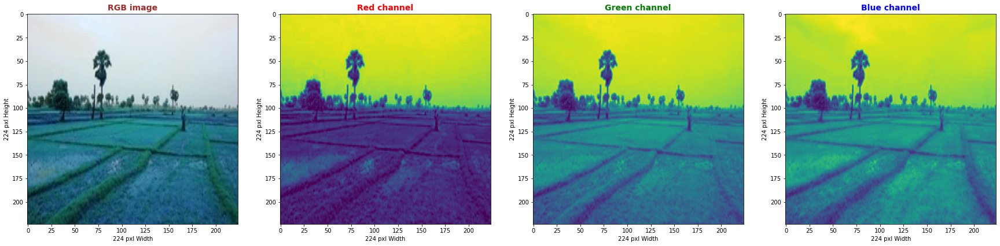

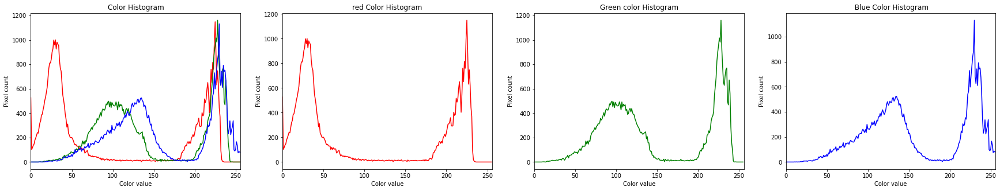

In [ ]:
image_pixel_analysis(wrong_data["path"].iloc[6],"rice",100,100) # wrong
image_pixel_analysis(correct_data["path"].iloc[0],"rice",100,100) # medium
image_pixel_analysis(correct_data["path"].iloc[75],"rice",100,100) # good

### 6.observation:

<pre>
observations:
1 . as per my observation most of the incorrectly classified images having low pixel values at the crop part in the image compare with correctly classified points images.

2. it is impossible to build the 100% correctly classified model .

3. generally there is some confusion between the labelled images of the crops.

4. There is some confusion between sugarcane,maize crops at the initial stages of the crop they both crops are lokking like similar pattrens of their leaves structure.

5. There is some confusion between sugarcane,jute crops at the middle stages of the crop they both are looks like same at certain point of view because both are height but leaves are different.

6. and there is some confusion between the rice and wheat crop at some stages and at cetrain angles of the images.

7. I perform some pixel analysis there is little bit values are changes in my pixel values it classified as different label.

8. To improve my model efficiency I need to add some more clear images of the rice crop images.
</pre>

### roof

##### observe good data crops pattren

In [ ]:
jute_idx3

[19, 27, 33, 46, 47, 69, 84]

In [ ]:
maize_idx3

[30, 31, 74, 79]

In [ ]:
rice_idx3

[75]

In [ ]:
sugarcane_idx3

[12, 15, 24, 36, 43, 49, 54, 59, 66, 76, 83]

In [ ]:
wheat_idx3

[25, 42, 52, 81, 86]

--------------------------------------------------------------------------------------------------JUTE--------------------------------------------------------------------------------------------------
pixel values at 100 row and 100 column.
Value of only R channel 49
Value of only G channel 145
Value of only B channel 115


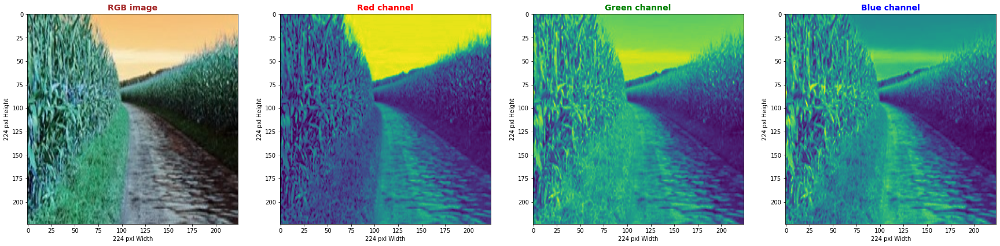

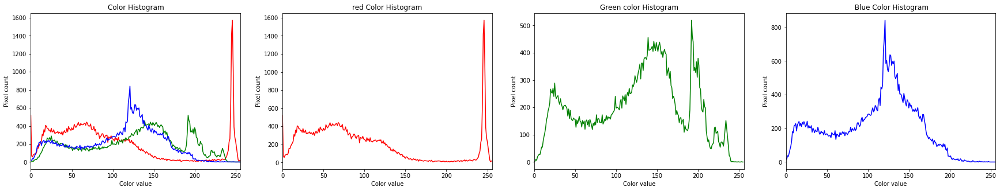

In [ ]:
id =31
image_pixel_analysis(correct_data["path"].iloc[id],"jute",100,100)